<a href="https://colab.research.google.com/github/taras-musakovskyi/colab-jupyter-fish-models/blob/main/fish_inpaint_lora_to_static_image.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Fish Inpainting with LoRA + SD 1.5 (Colab)

Upload an image and a LoRA `.safetensors` file. The notebook will create a random ellipse mask, load SD1.5 + LoRA, inpaint a goldfish, and show results side-by-side.

In [ ]:
!pip install -q \
  "torch" \
  "diffusers==0.27.2" \
  "transformers==4.40.2" \
  "accelerate==0.28.0" \
  "safetensors" \
  "peft==0.10.0" \
  "huggingface_hub==0.23.0"


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 401.2/401.2 kB 8.7 MB/s eta 0:00:00
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
gradio 5.49.0 requires huggingface-hub<2.0,>=0.33.5, but you have huggingface-hub 0.23.0 which is incompatible.
sentence-transformers 5.1.1 requires transformers<5.0.0,>=4.41.0, but you have transformers 4.40.2 which is incompatible.
datasets 4.0.0 requires huggingface-hub>=0.24.0, but you have huggingface-hub 0.23.0 which is incompatible.


In [ ]:
import torch
print('Torch', torch.__version__)
print('CUDA:', torch.cuda.is_available())

Torch 2.8.0+cu126
CUDA: True


In [ ]:
from google.colab import files
uploaded = files.upload()
print('Uploaded:', list(uploaded.keys()))
image_path=None
lora_path=None
for fn in uploaded.keys():
    if fn.lower().endswith(('.png','.jpg','.jpeg')) and image_path is None:
        image_path=fn
    if fn.lower().endswith('.safetensors') and lora_path is None:
        lora_path=fn
print('image_path=',image_path)
print('lora_path=',lora_path)

Saving back_up_this_one_lora_1b_best_epoch_24_20251006_121339.safetensors to back_up_this_one_lora_1b_best_epoch_24_20251006_121339 (1).safetensors
Saving shutterstock_1141039277.jpg to shutterstock_1141039277 (1).jpg
Uploaded: ['back_up_this_one_lora_1b_best_epoch_24_20251006_121339 (1).safetensors', 'shutterstock_1141039277 (1).jpg']
image_path= shutterstock_1141039277 (1).jpg
lora_path= back_up_this_one_lora_1b_best_epoch_24_20251006_121339 (1).safetensors


Original image size: 5050 3028
Saved /content/uploaded_image.png and /content/mask.png (random 1.5 ratio mask, 10% blend)


In [ ]:
import os,shutil,json,torch
from diffusers import StableDiffusionInpaintPipeline, EulerAncestralDiscreteScheduler
from peft import PeftModel
MODEL_NAME='runwayml/stable-diffusion-v1-5'
LORA_FILE = globals().get('lora_path',None)
assert LORA_FILE, 'Upload .safetensors LoRA as lora_path'
device='cuda' if torch.cuda.is_available() else 'cpu'
print('device',device)
pipe=StableDiffusionInpaintPipeline.from_pretrained(MODEL_NAME, torch_dtype=torch.float16 if device=='cuda' else torch.float32, safety_checker=None)
pipe.scheduler = EulerAncestralDiscreteScheduler.from_config(pipe.scheduler.config)
# prepare adapter dir
ad='/tmp/lora_adapter'
shutil.rmtree(ad, ignore_errors=True)
os.makedirs(ad, exist_ok=True)
shutil.copy(LORA_FILE, os.path.join(ad,'adapter_model.safetensors'))
adapter_config={'base_model_name_or_path':MODEL_NAME,'peft_type':'LORA','r':32,'lora_alpha':64,'target_modules':['to_k','to_q','to_v','to_out.0'],'lora_dropout':0.1}
with open(os.path.join(ad,'adapter_config.json'),'w') as f:
    json.dump(adapter_config,f,indent=2)
pipe.unet = PeftModel.from_pretrained(pipe.unet, ad, adapter_name=os.path.splitext(os.path.basename(LORA_FILE))[0])
pipe=pipe.to(device)
print('pipeline ready')

The cache for model files in Transformers v4.22.0 has been updated. Migrating your old cache. This is a one-time only operation. You can interrupt this and resume the migration later on by calling `transformers.utils.move_cache()`.


0it [00:00, ?it/s]

device cuda


/usr/local/lib/python3.12/dist-packages/huggingface_hub/utils/_token.py:89: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/huggingface_hub/file_download.py:1132: FutureWarning: `resume_download` is deprecated and will be removed in version 1.0.0. Downloads always resume when possible. If you want to force a new download, use `force_download=True`.
  warnings.warn(


model_index.json:   0%|          | 0.00/541 [00:00<?, ?B/s]

Fetching 13 files:   0%|          | 0/13 [00:00<?, ?it/s]

config.json:   0%|          | 0.00/617 [00:00<?, ?B/s]

preprocessor_config.json:   0%|          | 0.00/342 [00:00<?, ?B/s]

scheduler_config.json:   0%|          | 0.00/308 [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/472 [00:00<?, ?B/s]

vocab.json: 0.00B [00:00, ?B/s]

merges.txt: 0.00B [00:00, ?B/s]

tokenizer_config.json:   0%|          | 0.00/806 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/492M [00:00<?, ?B/s]

config.json:   0%|          | 0.00/743 [00:00<?, ?B/s]

diffusion_pytorch_model.safetensors:   0%|          | 0.00/335M [00:00<?, ?B/s]

diffusion_pytorch_model.safetensors:   0%|          | 0.00/3.44G [00:00<?, ?B/s]

config.json:   0%|          | 0.00/547 [00:00<?, ?B/s]

Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

You have disabled the safety checker for <class 'diffusers.pipelines.stable_diffusion.pipeline_stable_diffusion_inpaint.StableDiffusionInpaintPipeline'> by passing `safety_checker=None`. Ensure that you abide to the conditions of the Stable Diffusion license and do not expose unfiltered results in services or applications open to the public. Both the diffusers team and Hugging Face strongly recommend to keep the safety filter enabled in all public facing circumstances, disabling it only for use-cases that involve analyzing network behavior or auditing its results. For more information, please have a look at https://github.com/huggingface/diffusers/pull/254 .


pipeline ready


Original image size: 5050 3028
Saved /content/uploaded_image.png and /content/mask.png (random 1.5 ratio mask, 10% blend)
seed 1814208336


  0%|          | 0/50 [00:00<?, ?it/s]

Out image size: 2016 1208
Saved /content/inpainted.png
Out 2 image size: 2016 1208


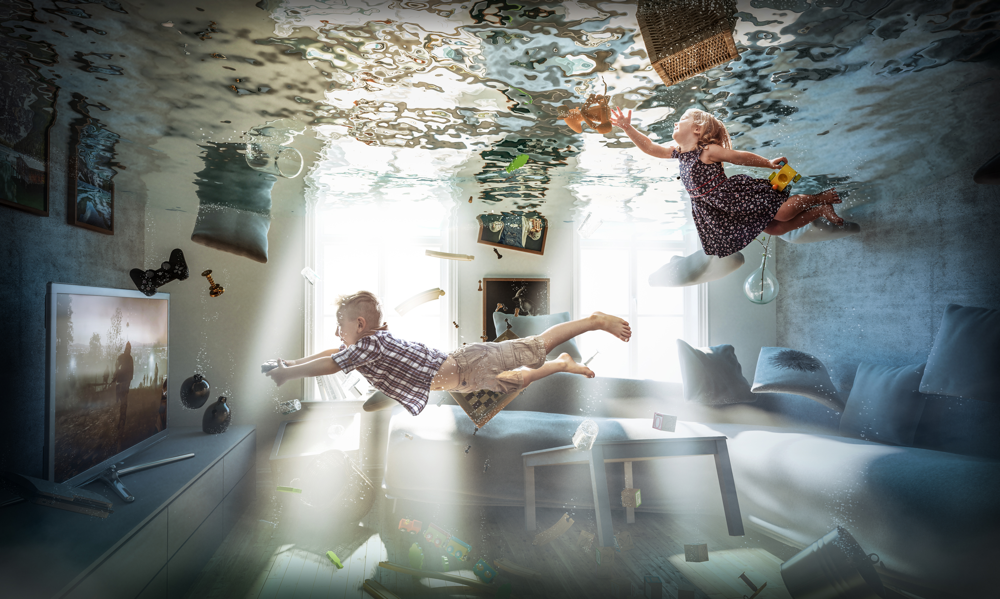

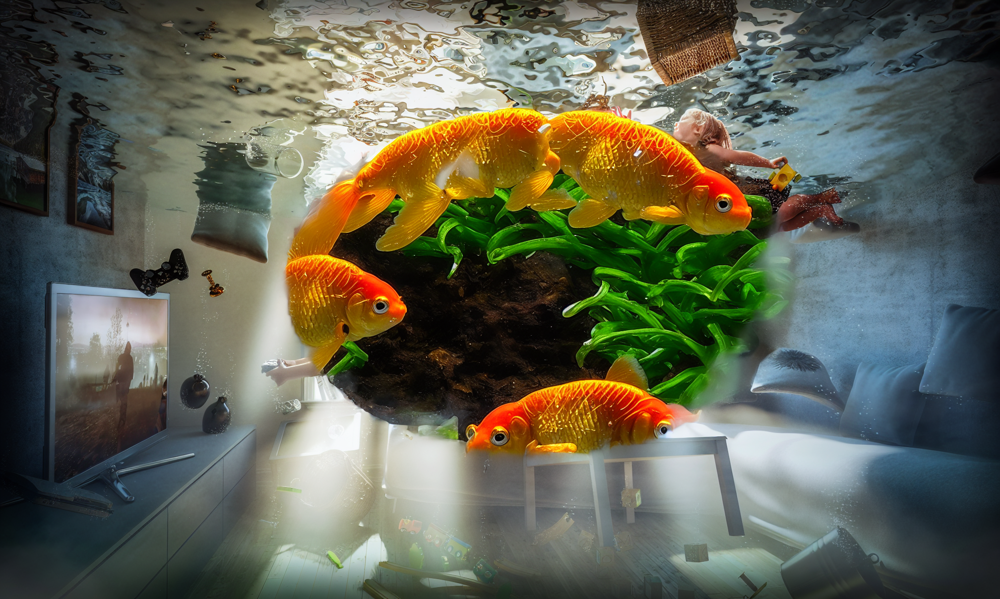

In [ ]:
from PIL import Image, ImageDraw, ImageFilter
import random

# --- Load uploaded image (no resizing or cropping) ---
assert 'image_path' in globals() and image_path
init_image = Image.open(image_path).convert('RGB')
w, h = init_image.size
print("Original image size:", w, h)

# --- Create mask with random size, 1.5 ratio, smaller than image ---
mask_image = Image.new("L", (w, h), 0)
draw = ImageDraw.Draw(mask_image)

# Random width: 30% - 70% of image width
mask_w = random.randint(int(w * 0.3), int(w * 0.7))
mask_h = int(mask_w / 1.5)  # 1.5 aspect ratio: wider than tall

# Random center, ensuring mask stays inside image
cx = random.randint(mask_w // 2, w - mask_w // 2)
cy = random.randint(mask_h // 2, h - mask_h // 2)

draw.ellipse(
    [cx - mask_w // 2, cy - mask_h // 2, cx + mask_w // 2, cy + mask_h // 2],
    fill=255
)

# Gaussian blur ~10% of mask width for smooth blending
blur_radius = int(mask_w * 0.1)
mask_image = mask_image.filter(ImageFilter.GaussianBlur(blur_radius))

# --- Save for inspection ---
init_image.save("/content/uploaded_image.png")
mask_image.save("/content/mask.png")
print("Saved /content/uploaded_image.png and /content/mask.png (random 1.5 ratio mask, 10% blend)")

# --- Optional: you can resize generated fish to mask size later ---
# mask_bbox = mask_image.getbbox()
# if mask_bbox:
#     fish_w = mask_bbox[2] - mask_bbox[0]
#     fish_h = mask_bbox[3] - mask_bbox[1]
#     out_resized = out.resize((fish_w, fish_h), Image.LANCZOS)


from PIL import Image
import torch, random
PROMPT='a complete single goldfish, full body from head to tail, highly detailed, clear water, sharp focus'
NEGATIVE=('multiple fish, duplicate, extra eyes, multiple eyes, double eyes, four eyes, deformed eyes, extra fins, '
          'multiple fins, duplicate fins, mutated, distorted, disfigured, malformed, duplicate body parts, '
          'motion blur, blurry, smooth, headless, no head, missing head, cropped head, decapitated, partial fish, '
          'cut off cropped, partial, cut off, incomplete, half fish, head only, tail only, body cut, edge of frame, '
          'plastic, metallic, aquarium glass, ribbed glass')
init_image=Image.open('/content/uploaded_image.png').convert('RGB')
mask_image=Image.open('/content/mask.png').convert('L')
seed=random.randint(0,2**31-1)
generator=torch.Generator(device=device).manual_seed(seed)
print('seed',seed)

init_image_resized = init_image#.resize((GEN_WIDTH, GEN_HEIGHT), Image.LANCZOS)
mask_resized = mask_image#.resize((GEN_WIDTH, GEN_HEIGHT), Image.LANCZOS)

# Run inpainting
out = pipe(
    prompt=PROMPT,
    negative_prompt=NEGATIVE,
    image=init_image,
    mask_image=mask_image,
    num_inference_steps=50,
    guidance_scale=6.5,
    generator=generator,
    width = (w // 20) * 8,
    height = (h // 20) * 8
).images[0]
w, h = out.size
print("Out image size:", w, h)
out.save('/content/inpainted.png')
print('Saved /content/inpainted.png')
w, h = out.size
print("Out 2 image size:", w, h)
from PIL import Image
orig=Image.open('/content/uploaded_image.png').convert('RGB')
out=Image.open('/content/inpainted.png').convert('RGB')
max_h=600
def resize_keep(img,max_h):
    w,h=img.size
    if h>max_h:
        new_w=int(w*(max_h/h))
        return img.resize((new_w,max_h))
    return img
#orig_r=resize_keep(orig,max_h)
#out_r=resize_keep(out,max_h)
#combined=Image.new('RGB',(orig_r.width+out_r.width+10,max_h),(255,255,255))
#combined.paste(orig_r,(0,0))
#combined.paste(out_r,(orig_r.width+10,0))
#display(combined)
display(orig)
display(out)
#w, h = init_image.size
#print("Out image size:", w, h)


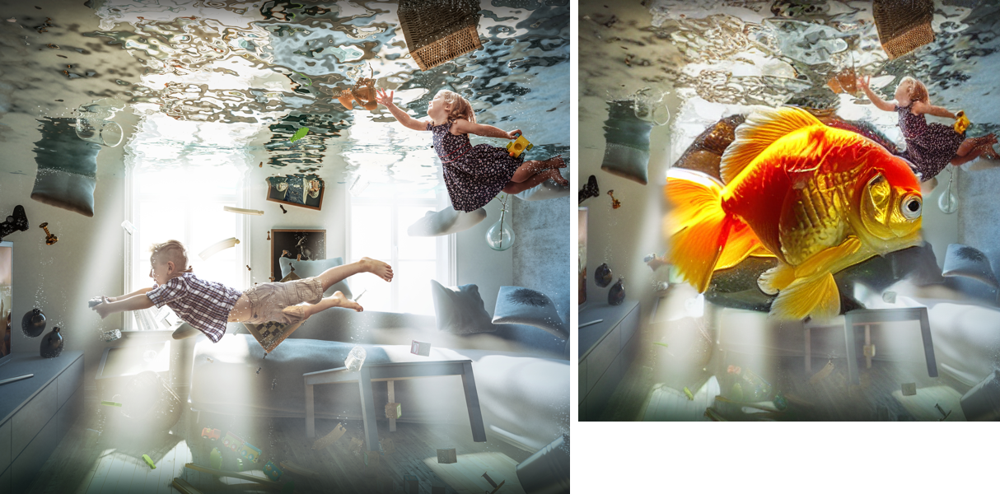